In [24]:
# extracts p from epubs, and cleans, adding PARAGRAPH_BREAK
import os
import re
import json
import pandas as pd

excluded_texts = ['Leviathan - Thomas Hobbes.txt', # old lang
                  'Nathan the Wise; a dramatic poem in five acts - Gotthold Ephraim Lessing.txt', # poem
                  'The Communist Manifesto - Karl Marx, Friedrich Engels.txt', # short para
                  'The Fable of the Bees; Or, Private Vices, Public Benefits - Bernard Mandeville.txt', # story
                  "Hegel's Philosophy of Mind - Georg Wilhelm Friedrich Hegel.txt", #NOT ORIGINAL
                  'An Inquiry Into the Nature and Causes of the Wealth of Nations - Adam Smith, M. Garnier.txt', # economic
                  'Primitive culture, vol. 1 (of 2) - Edward B. Tylor.txt', # anthropology
                  'Primitive culture, vol. 2 (of 2) - Edward B. Tylor.txt',
                  'Second Treatise of Government - John Locke.txt', #old langUAGE
                  'The Writings of Thomas Paine — Volume 4 (1794-1796)_ The Age of Reason - Thomas Paine.txt', # pol econ
                  'Three Dialogues Between Hylas and Philonous in Opposition to Sceptics and Atheists - George Berkeley.txt', #DIALOGUE
                  'Thus Spake Zarathustra_ A Book for All and None - Friedrich Wilhelm Nietzsche.txt', # dialogue / parable
                  'On the Origin of Species By Means of Natural Selection _ Or, the Preservation of Favoured Races in the Struggle for Life - Charles Darwin.txt', #very different topics
                  'An Inquiry into the Nature and Causes of the Wealth of Nations - Adam Smith.txt',
                  'The Descent of Man, and Selection in Relation to Sex - Charles Darwin.txt',
                  'Auguste Comte and Positivism - John Stuart Mill.txt'

                  ]

#re patterns
authors_note_pattern = re.compile(r' ?—( Author’s Note .) ?', re.IGNORECASE)
reference_pattern = re.compile(r' ?\[.+?\] ?', re.DOTALL)
extra_space_pattern = re.compile(r' {2,}')
starting_number_pattern = re.compile(r'\n( ?\d+ ?\.? ?)')
section_symbol_pattern = re.compile(r' ?§ ?\d* ?\.? ?')
paragraph_break_pattern = re.compile(r'PARAGRAPH_BREAK')
content_pattern = re.compile(r'CONTENT_START(.*?)CONTENT_END', re.DOTALL)
tab_pattern = re.compile(r'\n( *\t  *)')
num_pattern = re.compile(r' ?\(\d+?\) ?')
big_word_split_pattern = re.compile(r'\b[A-Z]{1}( )[A-Z]')
numeral_start_pattern = re.compile(r'\n( ?[IVXCM]+\. ?)')
num_parenth_pattern = re.compile(r'\(\d+?:?\d+?\) ?')
arrow_pattern = re.compile(r' ?[↑↓↩↪]+ ?')
connexion_pattern = re.compile(r'connexion', re.IGNORECASE)
chapter_break_pattern = re.compile(r'CHAPTER_BREAK')

asterisk_pattern = re.compile(r' ?\* ?')
double_space_pattern = re.compile(r' +')
newline_pattern = re.compile(r' ?\n ?')

class Cleaner:
    def __init__(self, folder_path_in, folder_path_out, metadata='gutenberg_metadata.csv'):
        self.folder_path_in = folder_path_in
        self.folder_path_out = folder_path_out
        if not os.path.exists(self.folder_path_out):
            os.makedirs(self.folder_path_out)
        self.df = pd.read_csv(metadata)
    
    def clean(self, content):
        content = re.sub(authors_note_pattern, ' ', content) # remove author notes
        content = re.sub(big_word_split_pattern,'',content) # artefacts of html like T REATISE
        content = re.sub(extra_space_pattern, ' ', content) # extra spaces
        content = re.sub(num_pattern,' ',content) # (1265)\s
        content = re.sub(reference_pattern, ' ', content) # references
        content = re.sub(starting_number_pattern, ' ', content) # starting with number.
        content = re.sub(section_symbol_pattern, ' ', content) # section symbols
        content = re.sub(tab_pattern, ' ', content) # remove tabs
        content = re.sub(numeral_start_pattern,' ',content)
        content = re.sub(num_parenth_pattern,' ',content)
        content = re.sub(arrow_pattern, ' ', content) # arrows
        content = re.sub(connexion_pattern, 'connection', content)
        
        content = re.sub(asterisk_pattern, ' ', content)
        content = re.sub(newline_pattern, ' ', content)
        content = re.sub(double_space_pattern, ' ', content)

        return content

    def extract_content(self, text):
        match = re.search(content_pattern, text)
        if match:
            return match.group(1).strip()
        return ''

    def get_metadata(file_path):
        head, tail = os.path.split(file_path)
        title = tail.split(' - ')[0].strip()
        row = self.df[self.df['Original Title'] == title]
        if not row.empty:
            metadata = row.iloc[0].to_dict()
            return metadata
        else:
            print(f'Metadata not found for {title}')
            return 'error'
        

    def split_chapters(self, content):
        chapters = re.split(chapter_break_pattern, content)
        chapter_list = []
        for idx, chapter in enumerate(chapters):
            if chapter.strip() == '':
                continue
            if chapter.count('\n') +1 >=5:
                chapter_list.append(chapter.strip())
        return chapter_list
   
    def split_paragraphs(self,content):
        content = re.split(paragraph_break_pattern, content)
        paragraph_list = []
        for paragraph in content:
            if paragraph.strip() == '':
                continue
            if paragraph.count('\n') +1 >= 5:
                paragraph_list.append(paragraph.strip())
        return paragraph_list

    # ind file
    def _process_file(self, file_path):
        head, tail = os.path.split(file_path)
        if tail in excluded_texts:
            return
        with open(file_path,'r', encoding='utf-8') as file:
            content = file.read()
        content = self.extract_content(content)
        if content == '':
            print(f'CONTENT NOT FOUND FOR {tail}')
            return
        
        metadata = get_metadata(file_path)
        result  = {
            "meta": metadata
        }
        per_chapter = self.split_chapters(content)
        chapters_end = []
        for c_idx, chapter in enumerate(per_chapter):
            per_paragraph = self.split_paragraphs(chapter)
            paragraphs_end = []
            for p_idx, paragraph in enumerate(per_paragraph):
                paragraph = self.clean(paragraph)
                paragraphs_end.append(paragraph)
            chapters_end.append(paragraphs_end)
        result['content'] = chapters_end

        save_path = os.path.join(self.folder_path_out,tail)
        #with open(save_path,'w',encoding='utf-8') as f:
        #    f.write(content)
        print(f'Processed {tail}')
        return result
    
    # general logic
    def process(self, path):
        if os.path.isfile(path):
            result_all = self._process_file(path)
            with open(os.path.join(self.folder_path_out, os.path.basename(path)), 'w', encoding='utf-8') as f:
                json.dump(result_all, f, ensure_ascii=False, indent=4)
        else:
            result_all = []
            for file in os.listdir(path):
                file_path = os.path.join(path,file)
                result = self._process_file(file_path)
                result_all.append(result)
            with open(os.path.join(self.folder_path_out, 'all_processed.json'), 'w', encoding='utf-8') as f:
                json.dump(result_all, f, ensure_ascii=False, indent=4)
        return result_all

folder_path_in = r'new_data_proc\extracted_texts_start_end\Essays - David Hume.txt'
folder_path_out = r'new\data_proc'

cleaner = Cleaner(folder_path_in=folder_path_in,folder_path_out=folder_path_out)
#cleaner.process(r'data_processing\extracted_texts\A System of Logic, Ratiocinative and Inductive - John Stuart Mill.txt')
cleaner.process(folder_path_in)

FileNotFoundError: [Errno 2] No such file or directory: 'gutenberg_metadata.csv'

In [21]:
print(chp)

None


In [5]:
import os
path = r'data_processing\input\epubs'
epub_files = [f for f in os.listdir(path) if f.endswith('.epub')]
print(epub_files)

['pg10615-images-3.epub', 'pg11224-images-3.epub', 'pg1228-images-3.epub', 'pg147-images-3.epub', 'pg15043-images-3.epub', 'pg16833-images-3.epub', 'pg17147-images-3.epub', 'pg1998-images-3.epub', 'pg2300-images-3.epub', 'pg2445-images-3.epub', 'pg26659-images-3.epub', 'pg27083-images-3.epub', 'pg27942-images-3.epub', 'pg29433-images-3.epub', 'pg2944-images-3.epub', 'pg2945-images-3.epub', 'pg3207-images-3.epub', 'pg3300-images-3.epub', 'pg34901-images-3.epub', 'pg36120-images-3.epub', 'pg3623-images-3.epub', 'pg3742-images-3.epub', 'pg3743-images-3.epub', 'pg3800-images-3.epub', 'pg38194-images-3.epub', 'pg3820-images-3.epub', 'pg39064-images-3.epub', 'pg4280-images-3.epub', 'pg4320-images-3.epub', 'pg4363-images-3.epub', 'pg44795-images-3.epub', 'pg4583-images-3.epub', 'pg46333-images-3.epub', 'pg47025-images-3.epub', 'pg4705-images-3.epub', 'pg4723-images-3.epub', 'pg4724-images-3.epub', 'pg48433-images-3.epub', 'pg51356-images-3.epub', 'pg52319-images-3.epub', 'pg52821-images-3.epu

Bert embeddings

In [4]:
import torch
from transformers import BertTokenizer, BertModel

# Re-using the model and tokenizer from the previous step
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')
model.eval()

# Get the base word embeddings and vocabulary again
embeddings = model.get_input_embeddings()
word_embeddings = embeddings.weight.data
vocab = tokenizer.get_vocab()
inverse_vocab = {v: k for k, v in vocab.items()}

# --- Define two different sentences for context ---
sentence_financial = "I need to deposit money at the bank."
sentence_geographical = "We had a picnic on the river bank."

def get_contextual_embedding_and_neighbors(sentence, target_word):
    """Tokenizes a sentence, gets the contextual embedding for the target word, and finds its nearest neighbors."""
    
    # Tokenize the sentence
    inputs = tokenizer(sentence, return_tensors='pt')
    tokens = tokenizer.convert_ids_to_tokens(inputs['input_ids'][0])
    
    # Find the index of our target word in the tokenized list
    try:
        # Note: Some words get split into sub-words (e.g., 'embedding' -> 'em', '##bed', '##ding')
        # This is a simplified approach assuming the word is a single token.
        target_word_index = tokens.index(target_word)
    except ValueError:
        print(f"Word '{target_word}' not found as a single token in the sentence.")
        return

    # Get the model's output (all hidden states)
    with torch.no_grad():
        outputs = model(**inputs)

    # The contextualized embedding is in the last_hidden_state
    last_hidden_states = outputs.last_hidden_state
    
    # Get the embedding for our target word from its position in the sentence
    contextual_embedding = last_hidden_states[0, target_word_index, :]

    # --- Find Nearest Neighbors for the Contextualized Embedding ---
    
    # Compare this new contextual embedding against all base embeddings in the vocabulary
    similarities = torch.nn.functional.cosine_similarity(contextual_embedding.unsqueeze(0), word_embeddings)
    top_10_similarities = torch.topk(similarities, 20)

    print(f"\n--- Context: '{sentence}' ---")
    print(f"--- Nearest Neighbors for the CONTEXTUALIZED embedding of '{target_word}' ---")
    for i in range(20):
        token_id = top_10_similarities.indices[i].item()
        token_str = inverse_vocab[token_id]
        similarity_score = top_10_similarities.values[i].item()
        print(f"{i+1}. {token_str:<15} (Similarity: {similarity_score:.4f})")

# --- Run the analysis for both sentences ---
get_contextual_embedding_and_neighbors(sentence_financial, "bank")
get_contextual_embedding_and_neighbors(sentence_geographical, "bank")



--- Context: 'I need to deposit money at the bank.' ---
--- Nearest Neighbors for the CONTEXTUALIZED embedding of 'bank' ---
1. bank            (Similarity: 0.2856)
2. banking         (Similarity: 0.1829)
3. banks           (Similarity: 0.1721)
4. ##bank          (Similarity: 0.1562)
5. banker          (Similarity: 0.1549)
6. aunt            (Similarity: 0.1515)
7. bankers         (Similarity: 0.1510)
8. grandmother     (Similarity: 0.1451)
9. cafe            (Similarity: 0.1397)
10. newspaper       (Similarity: 0.1395)
11. synagogue       (Similarity: 0.1388)
12. grandfather     (Similarity: 0.1387)
13. farm            (Similarity: 0.1364)
14. atm             (Similarity: 0.1363)
15. banco           (Similarity: 0.1348)
16. coins           (Similarity: 0.1339)
17. mortgage        (Similarity: 0.1317)
18. repay           (Similarity: 0.1287)
19. treasury        (Similarity: 0.1285)
20. airline         (Similarity: 0.1272)

--- Context: 'We had a picnic on the river bank.' ---
--- Near

In [ ]:
import torch
from transformers import BertTokenizer, BertModel

class Embed:
    def __init__(self,model_name='bert-base-uncased',word=None,sentence=None):
        self.model_name = model_name
        self.word = word
        self.sentence = sentence
        self.tokenizer = BertTokenizer.from_pretrained(model_name)
        self.model = BertModel.from_pretrained(model_name)
        self.model.eval()
        model.eval()
        self.embeddings = self.model.get_input_embeddings()
        self.vocab = self.tokenizer.get_vocab()
        self.inverse_vocab = {v: k for k, v in self.vocab.items()}

    def get_contextual_embedding_and_neighbors(sentence, target_word):
        """Tokenizes a sentence, gets the contextual embedding for the target word, and finds its nearest neighbors."""
        
        # Tokenize the sentence
        inputs = tokenizer(sentence, return_tensors='pt')
        tokens = tokenizer.convert_ids_to_tokens(inputs['input_ids'][0])
        
        # Find the index of our target word in the tokenized list
        try:
            # Note: Some words get split into sub-words (e.g., 'embedding' -> 'em', '##bed', '##ding')
            # This is a simplified approach assuming the word is a single token.
            target_word_index = tokens.index(target_word)
        except ValueError:
            print(f"Word '{target_word}' not found as a single token in the sentence.")
            return

        # Get the model's output (all hidden states)
        with torch.no_grad():
            outputs = model(**inputs)

        # The contextualized embedding is in the last_hidden_state
        last_hidden_states = outputs.last_hidden_state
        
        # Get the embedding for our target word from its position in the sentence
        contextual_embedding = last_hidden_states[0, target_word_index, :]

        # --- Find Nearest Neighbors for the Contextualized Embedding ---
        
        # Compare this new contextual embedding against all base embeddings in the vocabulary
        similarities = torch.nn.functional.cosine_similarity(contextual_embedding.unsqueeze(0), word_embeddings)
        top_10_similarities = torch.topk(similarities, 10)

        print(f"\n--- Context: '{sentence}' ---")
        print(f"--- Nearest Neighbors for the CONTEXTUALIZED embedding of '{target_word}' ---")
        for i in range(10):
            token_id = top_10_similarities.indices[i].item()
            token_str = inverse_vocab[token_id]
            similarity_score = top_10_similarities.values[i].item()
            print(f"{i+1}. {token_str:<15} (Similarity: {similarity_score:.4f})")


# Load pre-trained model tokenizer and model
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')

# Set the model to evaluation mode
model.eval()

# --- Part 1: Base (Static) Embedding ---

target_word = "bank"

# Get the entire word embedding matrix from the model
# These are the "base" embeddings, before any contextualization
embeddings = model.get_input_embeddings()
word_embeddings = embeddings.weight.data

# Get the vocabulary from the tokenizer
vocab = tokenizer.get_vocab()
# Create an inverse vocabulary to map indices to tokens
inverse_vocab = {v: k for k, v in vocab.items()}

# Get the ID of our target word in the vocabulary
target_word_id = vocab[target_word]

# Get the base embedding for the target word
target_word_embedding = word_embeddings[target_word_id]

# --- Find Nearest Neighbors for the Base Embedding ---

# Calculate cosine similarity between our target word's embedding and all other word embeddings
# The formula is (a . b) / (||a|| * ||b||)
# We can do this efficiently with matrix operations.
similarities = torch.nn.functional.cosine_similarity(target_word_embedding.unsqueeze(0), word_embeddings)

# Find the top 10 most similar words
top_10_similarities = torch.topk(similarities, 10)

print(f"--- Nearest Neighbors for the BASE embedding of '{target_word}' ---")
for i in range(10):
    token_id = top_10_similarities.indices[i].item()
    token_str = inverse_vocab[token_id]
    similarity_score = top_10_similarities.values[i].item()
    print(f"{i+1}. {token_str:<15} (Similarity: {similarity_score:.4f})")


c:\Users\User\conda_envs\nlp\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


--- Nearest Neighbors for the BASE embedding of 'bank' ---
1. bank            (Similarity: 1.0000)
2. banks           (Similarity: 0.6617)
3. ##bank          (Similarity: 0.5834)
4. banking         (Similarity: 0.5381)
5. banker          (Similarity: 0.5005)
6. banco           (Similarity: 0.4756)
7. bankers         (Similarity: 0.4714)
8. 219             (Similarity: 0.4250)
9. 278             (Similarity: 0.4148)
10. 1751            (Similarity: 0.4147)


main

In [76]:
import os
excluded_texts = ['Leviathan - Thomas Hobbes.txt',
                  'Nathan the Wise; a dramatic poem in five acts - Gotthold Ephraim Lessing.txt',
                  'The Communist Manifesto - Karl Marx, Friedrich Engels.txt',
                  'The Fable of the Bees; Or, Private Vices, Public Benefits - Bernard Mandeville.txt',
                  "Hegel's Philosophy of Mind - Georg Wilhelm Friedrich Hegel.txt", #NOT ORIGINAL
                  'An Inquiry Into the Nature and Causes of the Wealth of Nations - Adam Smith, M. Garnier.txt',
                  'Primitive culture, vol. 1 (of 2) - Edward B. Tylor.txt',
                  'Primitive culture, vol. 2 (of 2) - Edward B. Tylor.txt',
                  'Second Treatise of Government - John Locke.txt', #old langUAGE
                  'The Writings of Thomas Paine — Volume 4 (1794-1796)_ The Age of Reason - Thomas Paine.txt',
                  'Theologico-Political Treatise — Part 2 - Benedictus de Spinoza.txt',
                  'Three Dialogues Between Hylas and Philonous in Opposition to Sceptics and Atheists - George Berkeley.txt', #DIALOGUE
                  'Thus Spake Zarathustra_ A Book for All and None - Friedrich Wilhelm Nietzsche.txt', # dialogue / parable
                  'On the Origin of Species By Means of Natural Selection _ Or, the Preservation of Favoured Races in the Struggle for Life - Charles Darwin.txt', #very different topics
                  'An Inquiry into the Nature and Causes of the Wealth of Nations - Adam Smith.txt',
                  'The Descent of Man, and Selection in Relation to Sex - Charles Darwin.txt',
                  'Auguste Comte and Positivism - John Stuart Mill.txt'

                  ]
for file in os.listdir(r'data_processing\extracted_texts_start_end'):
    if file not in excluded_texts:
        print(file)

A System of Logic, Ratiocinative and Inductive - John Stuart Mill.txt
A Theological-Political Treatise [Part III] - Benedictus de Spinoza.txt
A Theological-Political Treatise [Part IV] - Benedictus de Spinoza.txt
A Treatise Concerning the Principles of Human Knowledge - George Berkeley.txt
A Treatise of Human Nature - David Hume.txt
Aids to Reflection; and, The Confessions of an Inquiring Spirit - Samuel Taylor Coleridge.txt
An Enquiry Concerning Human Understanding - David Hume.txt
An Enquiry Concerning the Principles of Morals - David Hume.txt
An Essay Concerning Humane Understanding, Volume 1 _ MDCXC, Based on the 2nd Edition, Books 1 and 2 - John Locke.txt
Analysis of the Phenomena of the Human Mind - James Mill.txt
Beyond Good and Evil - Friedrich Wilhelm Nietzsche.txt
Chance, Love, and Logic_ Philosophical Essays - Charles S. Peirce.txt
Common Sense - Thomas Paine.txt
Dialogues Concerning Natural Religion - David Hume.txt
Essays - David Hume.txt
Essays — First Series - Ralph Wald

In [ ]:
def extract_content_start_end(folder, file=None):
    

CLEAN PREPROCESSING

In [ ]:
import os
import re
import csv
import ebooklib
from ebooklib import epub
from bs4 import BeautifulSoup, NavigableString, Tag # Import Tag

# --- Configuration ---
INPUT_EPUB_FOLDER = r"input\epubs"  # Folder containing your EPUB files
OUTPUT_TEXT_FOLDER = "extracted_texts"
OUTPUT_METADATA_CSV = "gutenberg_metadata.csv"

# --- Helper Functions ---
def sanitize_filename(name):
    """Removes or replaces characters that are invalid in filenames."""
    name = re.sub(r'[<>:"/\\|?*]', '_', name)
    name = re.sub(r'\s+', ' ', name).strip() # Consolidate whitespace
    name = name[:150] # Limit filename length to avoid issues
    return name

def extract_year(date_string):
    """Extracts the year from a typical EPUB date string (e.g., YYYY-MM-DD or just YYYY)."""
    if not date_string:
        return ""
    match = re.search(r'^(\d{4})', date_string)
    return match.group(1) if match else ""

def get_first_metadata_value(book, namespace, tag, default="Unknown"):
    """Safely extracts the first metadata value or a default."""
    meta_list = book.get_metadata(namespace, tag)
    if meta_list and meta_list[0] and meta_list[0][0]:
        return meta_list[0][0]
    return default

# --- Main Script ---
def process_gutenberg_epubs(epub_folder, text_output_folder, metadata_csv_file):
    if not os.path.exists(epub_folder):
        print(f"Error: Input folder '{epub_folder}' not found.")
        return

    os.makedirs(text_output_folder, exist_ok=True)

    all_metadata_entries = []
    processed_files_count = 0
    failed_files_count = 0

    print(f"Starting processing of EPUBs in '{epub_folder}'...")

    for filename in os.listdir(epub_folder):
        if filename.lower().endswith(".epub"):
            epub_path = os.path.join(epub_folder, filename)
            print(f"\nProcessing: {filename}")

            try:
                book = epub.read_epub(epub_path)

                # 1. Extract Metadata (same as before)
                title = get_first_metadata_value(book, 'DC', 'title', "Untitled")
                primary_authors = []
                for name, attrs in book.get_metadata('DC', 'creator'):
                    role = attrs.get('opf:role', attrs.get('role', '')).lower()
                    if role == 'aut':
                        primary_authors.append(name)
                if not primary_authors:
                    primary_authors = [item[0] for item in book.get_metadata('DC', 'creator') if item and item[0]]
                original_writer_str = ", ".join(primary_authors) if primary_authors else "Unknown Author"
                translators = []
                other_contributors_info = []
                for name, attrs in book.get_metadata('DC', 'contributor'):
                    role = attrs.get('opf:role', attrs.get('role', '')).lower()
                    if role == 'trl':
                        translators.append(name)
                    elif name:
                        other_contributors_info.append(f"{name}" + (f" ({role})" if role else " (contributor)"))
                for name, attrs in book.get_metadata('DC', 'creator'):
                    if name not in primary_authors:
                        role = attrs.get('opf:role', attrs.get('role', '')).lower()
                        if role and role != 'aut':
                            if not any(name in t for t in translators) and \
                               not any(name in o for o in other_contributors_info):
                                other_contributors_info.append(f"{name} ({role})")
                translator_contributor_display_parts = []
                if translators:
                    translator_contributor_display_parts.append("Translator: " + ", ".join(translators))
                if other_contributors_info:
                    translator_contributor_display_parts.append("Other: " + ", ".join(other_contributors_info))
                translator_contributor_final_str = "; ".join(translator_contributor_display_parts)
                version_pub_date_raw = get_first_metadata_value(book, 'DC', 'date', "")
                version_pub_year = extract_year(version_pub_date_raw)
                current_book_metadata = {
                    "Original Title": title,
                    "Original Writer": original_writer_str,
                    "Publication Year (Original)": "",
                    "Translator/Contributor": translator_contributor_final_str,
                    "Publication Year (Version)": version_pub_year,
                    "Source EPUB": filename
                }
                all_metadata_entries.append(current_book_metadata)

                # 2. Prepare Output Text Filename (same as before)
                safe_title = sanitize_filename(title)
                safe_author = sanitize_filename(original_writer_str)
                output_text_filename = f"{safe_title} - {safe_author}.txt"
                output_text_path = os.path.join(text_output_folder, output_text_filename)

                # 3. Extract and Segment Text - MODIFIED SECTION
                full_text_content_parts = []

                # Iterate through items to find chapter and paragraph elements
                for item in book.spine:
                    doc_item = book.get_item_with_id(item[0])
                    if not doc_item or doc_item.get_type() != ebooklib.ITEM_DOCUMENT:
                        continue

                    soup = BeautifulSoup(doc_item.get_content(), 'html.parser')
                    body_content = soup.find('body')  # CHANGE omit looking for body -> content_start / _end , get surrounding text, insert back later
                    if not body_content:
                        continue
                    paragraphs = body_content.find_all('p')
                    for p in paragraphs:
                        text = p.get_text(separator=' ', strip=True)
                        if text:
                            full_text_content_parts.append(text)  #took out big chunk here

                                                               
                # 4. Write Text File (same as before)
                with open(output_text_path, 'w', encoding='utf-8') as f:
                    f.write("\nPARAGRAPH_BREAK\n".join(full_text_content_parts))
                print(f"  Extracted text to: {output_text_path}")
                processed_files_count += 1

            except Exception as e:
                print(f"  Error processing {filename}: {e}")
                failed_files_count +=1

    # 5. Write Metadata CSV (same as before)
    if all_metadata_entries:
        csv_fieldnames = [
            "Original Title", "Original Writer", "Publication Year (Original)",
            "Translator/Contributor", "Publication Year (Version)", "Source EPUB"
        ]
        with open(metadata_csv_file, 'w', newline='', encoding='utf-8') as csvfile:
            writer = csv.DictWriter(csvfile, fieldnames=csv_fieldnames)
            writer.writeheader()
            writer.writerows(all_metadata_entries)
        print(f"\nMetadata written to: {metadata_csv_file}")
    else:
        print("\nNo metadata extracted (no EPUBs processed successfully or none found).")

    print(f"\n--- Summary ---")
    print(f"Total EPUBs attempted: {processed_files_count + failed_files_count}")
    print(f"Successfully processed: {processed_files_count}")
    print(f"Failed to process: {failed_files_count}")
    print("Done.")

# --- Run the script ---
if __name__ == "__main__":
    if not os.path.exists(INPUT_EPUB_FOLDER):
        os.makedirs(INPUT_EPUB_FOLDER)
        print(f"Created input folder: '{INPUT_EPUB_FOLDER}'. Please place your EPUB files there.")

    process_gutenberg_epubs(INPUT_EPUB_FOLDER, OUTPUT_TEXT_FOLDER, OUTPUT_METADATA_CSV)


# Find all h2 (for chapters) and p (for paragraphs) tags in order
# We will iterate through them to maintain the document flow
# This approach is simpler for the current requirement.
'''
chapter_or_paragraph_elements = []
# Common chapter containers - adjust if needed
chapter_divs = body_content.find_all('div', class_=['chapter', 'tei-div'], recursive=False) # Look at top-level divs first

if chapter_divs: # If specific chapter divs are found, process within them
    for ch_div in chapter_divs:
        # Skip boilerplate if the div itself is a known boilerplate container
        div_classes = ch_div.get('class', [])
        div_id = ch_div.get('id', '')
        if 'pg-boilerplate' in div_classes or \
            'pgheader' in div_classes or \
            'pgfooter' in div_classes or \
            'toc' in div_classes or \
            div_id in ['pg-header', 'pg-footer', 'pgepub-license', 'pg-machine-header'] or \
            'pg-start-separator' in div_id or 'pg-end-separator' in div_id:
            continue
        
        # Find h2 and p tags within this chapter div
        for element in ch_div.find_all(['h1', 'h2', 'h3', 'h4', 'h5', 'h6', 'p'], recursive=True): # Recursive True here
            chapter_or_paragraph_elements.append(element)
else: # Fallback: process all h2 and p tags directly under body
        for element in body_content.find_all(['h1', 'h2', 'h3', 'h4', 'h5', 'h6', 'p'], recursive=True):
        chapter_or_paragraph_elements.append(element)


for element in chapter_or_paragraph_elements:
    # --- Skip Gutenberg boilerplate and unwanted sections based on element's own properties ---
    element_classes = element.get('class', [])
    element_id = element.get('id', '')
    
    # More robust boilerplate check on the element itself
    if 'pg-boilerplate' in element_classes or \
        'pgheader' in element_classes or \
        'pgfooter' in element_classes or \
        'toc' in element_classes or \
        element_id in ['pg-header', 'pg-footer', 'pgepub-license', 'pg-machine-header'] or \
        'pg-start-separator' in element_id or 'pg-end-separator' in element_id:
        continue

    text_for_check = element.get_text(" ", strip=True).upper()
    if ("PROJECT GUTENBERG" in text_for_check and \
        ("EBOOK" in text_for_check or "LICENSE" in text_for_check or "COPYRIGHT" in text_for_check)) or \
        "*** START OF" in text_for_check or "*** END OF" in text_for_check :
        if len(text_for_check) < 300: # Assume small boilerplate sections
            continue
    
    if element.name in ['h1', 'h2', 'h3', 'h4', 'h5', 'h6']:
        chapter_title_text = element.get_text(separator=' ', strip=True)
        # Filter out boilerplate titles or very short/non-content titles
        # (e.g., just "Chapter X" might be less useful than a descriptive title)
        if chapter_title_text and len(chapter_title_text) > 3 and \
            not "CONTENTS" in chapter_title_text.upper() and \
            not "INDEX" in chapter_title_text.upper() and \
            not "NOTES" in chapter_title_text.upper() and \
            not "APPENDIX" in chapter_title_text.upper() and \
            not "INTRODUCTION" in chapter_title_text.upper() and \
            not "PREFACE" in chapter_title_text.upper() and \
            not "TRANSCR" in chapter_title_text.upper(): # Avoid transcriber's notes as chapters
            full_text_content_parts.append("CHAPTER_BREAK")
            full_text_content_parts.append(chapter_title_text)
    
    elif element.name == 'p':
        # --- MODIFICATION: Extract inner HTML of <p> tags ---
        # Instead of .get_text(), we get the string representation of children
        paragraph_inner_html = "".join(str(child) for child in element.contents).strip()
        
        # Basic filter for meaningful paragraphs
        # Check length of text content for this filter, not raw HTML
        paragraph_text_for_check = element.get_text(separator=' ', strip=True)
        if paragraph_text_for_check and len(paragraph_text_for_check) > 10 :
            # Filter out image placeholders (often within <p>)
            if not paragraph_text_for_check.startswith("Illustration:") and \
                not paragraph_text_for_check.startswith("[Illustration") and \
                not element.find('img'): # also check for img tags inside
                full_text_content_parts.append("PARAGRAPH_BREAK")
                full_text_content_parts.append(paragraph_inner_html)
# --- END OF MODIFIED SECTION ---
'''


In [ ]:
# FINE GRAINED
docs_subset = [...]
embeddings_subset = [...]
from sklearn.feature_extraction.text import CountVectorizer
logger.info("Starting fine-grained sub-clustering with sensitive parameters...")

# --- Create a "Microscope" BERTopic Model ---

# 1. Define highly sensitive UMAP and HDBSCAN models
sensitive_umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)

sensitive_hdbscan_model = HDBSCAN(
    min_cluster_size=10,
    min_samples=5,
    metric='cosine',
    cluster_selection_method='leaf', # Use 'leaf' for fine-grained topics
    prediction_data=True
)

# 2. Instantiate a new BERTopic model with these components
sub_topic_model = BERTopic(
    umap_model=sensitive_umap_model,
    hdbscan_model=sensitive_hdbscan_model,
    language="english",
    verbose=True
)

# 3. Fit the model on your subset
sub_topics, _ = sub_topic_model.fit_transform(docs_subset, embeddings=embeddings_subset)

# 4. Analyze the results
print(sub_topic_model.get_topic_info())

# --- Iterate and Refine ---
# If you get too many tiny topics, slightly increase min_cluster_size (e.g., to 15 or 20).
# If the topics are still too broad, slightly decrease n_neighbors (e.g., to 5).
# This interactive process is much more effective than re-running the whole Optuna search.

In [ ]:
# with custom vectorizer
from sklearn.feature_extraction.text import CountVectorizer

# Create a vectorizer that IGNORES default stopwords
# and instead focuses on words specific to your philosophy corpus.
custom_vectorizer = CountVectorizer(
    stop_words=None, # No default stop words
    min_df=5,        # Word must appear in at least 5 paragraphs to be considered
    max_df=0.8       # Ignore words that appear in >80% of paragraphs (like 'the', 'is', if they weren't already filtered)
)

# Then plug this into your sub_topic_model
sub_topic_model = BERTopic(
    #...
    vectorizer_model=custom_vectorizer,
    #...
)

testing

In [73]:
from bertopic import BERTopic

class easy:
    def __init__(self, model, docs, embeddings):
        self.model = model
        self.docs = docs
        self.embeddings = embeddings

    def get_topics(self):
        return self.model.get_topic_info()

    def get_topic(self, topic_id):
        return self.model.get_topic(topic_id)

    def get_document_topics(self, doc):
        return self.model.transform([doc])


model_path_full = r'BERTOPIC\final_bertopic_model_optimized_full_data'
model_path_subcluster = r'BERTOPIC\final_bertopic_model_optimized_main_cluster'
sub2 = r'BERTOPIC\final_bertopic_model_optimized_subcluster2'
topic_model = BERTopic.load(model_path_full)

Sun Jun  8 21:35:11 2025 Building and compiling search function


In [74]:
topic_model.visualize_topics().show()

In [72]:
df = topic_model.get_topic_info()
df

,Topic,Count,Name,Representation,Representative_Docs
0,-1,3277,-1_belief_consciousness_necessity_principle,"[belief, consciousness, necessity, principle, ...",[There is some need for additional elucidation...
1,0,14186,0_philosophy_consciousness_principle_belief,"[philosophy, consciousness, principle, belief,...","[Here, then, many philosophers think themselve..."
2,1,570,1_dionysian_dionysus_artistic_socrates,"[dionysian, dionysus, artistic, socrates, poet...",[We shall have gained much for the science of ...
3,2,541,2_constitution_governments_government_monarchy,"[constitution, governments, government, monarc...",[That men mean distinct and separate things wh...
4,3,263,3_folk_midsummer_harvest_bonfires,"[folk, midsummer, harvest, bonfires, trees, tr...",[WE have now seen that the corn-spirit is repr...
5,4,72,4_deum_filium_quæ_augustinus,"[deum, filium, quæ, augustinus, quae, nec, deu...",[Some curious instances of false analogy are t...
6,5,69,5_taxation_debt_taxes_thousand,"[taxation, debt, taxes, thousand, tax, shillin...",[Every year some part of this sum of half a mi...
7,6,45,6_baptism_baptismal_communion_sacraments,"[baptism, baptismal, communion, sacraments, sa...",[With regard to the true bearing of my analysi...
8,7,25,7_latin_conjugations_greek_languages,"[latin, conjugations, greek, languages, verbs,...",[The Latin is a composition of the Greek and o...
9,8,20,8_stimuli_stimulus_sensations_perception,"[stimuli, stimulus, sensations, perception, fe...",[Mr. J. M. Cattell found he could get no resul...


In [63]:
df.iloc[9]['Representative_Docs']

['These three sets of instances admit of being treated according to the Method of Agreement. In all of them the metallic compounds are brought into contact with the substances which compose the human or animal body; and the instances do not seem to agree in any other circumstance. The remaining antecedents are as different, and even opposite, as they could possibly be made; for in some the animal substances exposed to the action of the poisons are in a state of life, in others only in a state of organization, in others not even in that. And what is the result which follows in all the cases? The conversion of the animal substance (by combination with the poison) into a chemical compound, held together by so powerful a force as to resist the subsequent action of the ordinary causes of decomposition. Now, organic life (the necessary condition of sensitive life) consisting in a continual state of decomposition and recomposition of the different organs and tissues, whatever incapacitates th

In [66]:
# sanity check
import json
with open(r'data_processing\data.json', 'r') as file:
    data = json.load(file)
DOCS_FULL = []
for item in data:
    DOCS_FULL.extend(item.get('paragraphs'))

with open(r'data_processing\data_subset.json','r') as f:
    data_subset = json.load(f)

# Get a DataFrame with document-topic information 
document_info = topic_model.get_document_info(data_subset) # 'docs' are your original documents 

# Filter for a specific topic (e.g., topic 5) 
topic_n = document_info[document_info['Topic'] == 0]
topic_n
topic_docs = topic_n.Document.tolist()

title_counter = {}
for entry in data:
    for doc in topic_docs:
        if doc in entry.get('paragraphs'):
            title_counter[entry.get('title')] = title_counter.get(entry.get('title'), 0) + 1
            para_idx = entry.get('paragraphs').index(doc)
            print('---')
            print(f'{doc}')
            print(f'{entry.get('title')}: {entry.get('idx')[para_idx]}')
print('===')
for k, v in title_counter.items():
    print(f'{k}: {v}')


---
This book makes no pretense of giving to the world a new theory of the intellectual operations. Its claim to attention, if it possess any, is grounded on the fact that it is an attempt, not to supersede, but to embody and systematize, the best ideas which have been either promulgated on its subject by speculative writers, or conformed to by accurate thinkers in their scientific inquiries.
A System of Logic, Ratiocinative and Inductive - John Stuart Mill.txt: 0
---
To cement together the detached fragments of a subject, never yet treated as a whole; to harmonize the true portions of discordant theories, by supplying the links of thought necessary to connect them, and by disentangling them from the errors with which they are always more or less interwoven, must necessarily require a considerable amount of original speculation. To other originality than this, the present work lays no claim. In the existing state of the cultivation of the sciences, there would be a very strong presumpt

In [68]:
# sanity check
import json
with open(r'data_processing\data.json', 'r') as file:
    data = json.load(file)
DOCS_FULL = []
for item in data:
    DOCS_FULL.extend(item.get('paragraphs'))

with open(r'data_processing\data_subset.json','r') as f:
    data_subset = json.load(f)

# Get a DataFrame with document-topic information 
document_info = topic_model.get_document_info(data_subset) # 'docs' are your original documents 

# Filter for a specific topic (e.g., topic 5) 
topic_n = document_info[document_info['Topic'] == 10]
topic_n
topic_docs = topic_n.Document.tolist()

title_counter = {}
for entry in data:
    for doc in topic_docs:
        if doc in entry.get('paragraphs'):
            title_counter[entry.get('title')] = title_counter.get(entry.get('title'), 0) + 1
            para_idx = entry.get('paragraphs').index(doc)
            print('---')
            print(f'{doc}')
            print(f'{entry.get('title')}: {entry.get('idx')[para_idx]}')
print('===')
for k, v in title_counter.items():
    print(f'{k}: {v}')


---
In studies of numbers, the idea of continuity is so indispensable, that it is perpetually introduced even where there is no continuity in fact, as where we say that there are in the United States 10.7 inhabitants per square mile, or that in New York 14.72 persons live in the average house. Another example is that law of the distribution of errors which Quetelet, Galton, and others, have applied with so much success to the study of biological and social matters. This application of continuity to cases where it does not really exist illustrates, also, another point which will hereafter demand a separate study, namely, the great utility which fictions sometimes have in science.
Chance, Love, and Logic_ Philosophical Essays - Charles S. Peirce.txt: 118
---
We now come to the difficult question. What is continuity? Kant confounds it with infinite divisibility, saying that the essential character of a continuous series is that between any two members of it a third can always be found. Th

In [69]:

import json
final_topics = topic_model.topics_

topics_to_keep = [-1, 0]
indices_to_keep = [i for i, topic_id in enumerate(final_topics) if topic_id in topics_to_keep]

docs_subset = [DOCS_FULL[i] for i in indices_to_keep]
#embeddings_subset = EMBEDDINGS_FULL[indices_to_keep]
with open(r'data_processing\data_subset2.json','w') as f:
    json.dump(docs_subset,f)

In [57]:
docs_subset

['This book makes no pretense of giving to the world a new theory of the intellectual operations. Its claim to attention, if it possess any, is grounded on the fact that it is an attempt, not to supersede, but to embody and systematize, the best ideas which have been either promulgated on its subject by speculative writers, or conformed to by accurate thinkers in their scientific inquiries.',
 'To cement together the detached fragments of a subject, never yet treated as a whole; to harmonize the true portions of discordant theories, by supplying the links of thought necessary to connect them, and by disentangling them from the errors with which they are always more or less interwoven, must necessarily require a considerable amount of original speculation. To other originality than this, the present work lays no claim. In the existing state of the cultivation of the sciences, there would be a very strong presumption against any one who should imagine that he had effected a revolution in

In [ ]:

# 2. Create a NEW BERTopic instance to find sub-topics.
# CRUCIAL: Use more sensitive parameters to encourage smaller clusters!
sub_topic_model = BERTopic(
    # Use smaller min_cluster_size to find more granular topics
    hdbscan_model=HDBSCAN(min_cluster_size=10, metric='cosine'), 
    verbose=True,
    # You can keep other parameters (vectorizer, etc.) from your best model
)

# 3. Fit the new model ONLY on the subset of data.
sub_topics, _ = sub_topic_model.fit_transform(docs_subset, embeddings=embeddings_subset)

# Now, inspect the topics found by `sub_topic_model`. These are the
# sub-topics of your original big cluster.
sub_topic_model.get_topic_info()

In [53]:
hierarchical_topics = topic_model.hierarchical_topics(docs=DOCS_FULL)
topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)

100%|██████████| 4/4 [00:01<00:00,  3.71it/s]


In [ ]:
E:\code\dta\cls\exam\histbert

In [22]:
# sanity check
import json
with open(r'data_processing\data.json', 'r') as file:
    data = json.load(file)
short_count = 0
for item in data:
    for idx, para in enumerate(item.get('paragraphs', [])):
        if not isinstance(para, str):
            print(f"Item at index {idx} is not a string: {item.get('title')}")
            break
        elif len(para) < 5:
            print(f"Item at index {idx} is too short: {item.get('paragraphs')[idx]}")
            short_count +=1

    else: continue

In [31]:
with open(r'data_processing\data.json') as f:
    data = json.load(f)

result_dict = {}
for item in data:
    result_dict[item.get('title')] = len(item.get('paragraphs'))


In [32]:
result_dict

{'A System of Logic, Ratiocinative and Inductive - John Stuart Mill.txt': 1819,
 'A Theological-Political Treatise [Part III] - Benedictus de Spinoza.txt': 110,
 'A Theological-Political Treatise [Part IV] - Benedictus de Spinoza.txt': 173,
 'A Treatise Concerning the Principles of Human Knowledge - George Berkeley.txt': 184,
 'A Treatise of Human Nature - David Hume.txt': 1256,
 'Aids to Reflection; and, The Confessions of an Inquiring Spirit - Samuel Taylor Coleridge.txt': 788,
 'An Enquiry Concerning Human Understanding - David Hume.txt': 254,
 'An Enquiry Concerning the Principles of Morals - David Hume.txt': 311,
 'An Essay Concerning Humane Understanding, Volume 1 _ MDCXC, Based on the 2nd Edition, Books 1 and 2 - John Locke.txt': 693,
 'An Inquiry into the Nature and Causes of the Wealth of Nations - Adam Smith.txt': 1997,
 'Analysis of the Phenomena of the Human Mind - James Mill.txt': 2105,
 'Auguste Comte and Positivism - John Stuart Mill.txt': 131,
 'Beyond Good and Evil - F

C:\Users\User\AppData\Local\Temp\ipykernel_2808\3265093731.py:32: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout() # Adjust layout to prevent labels from overlapping


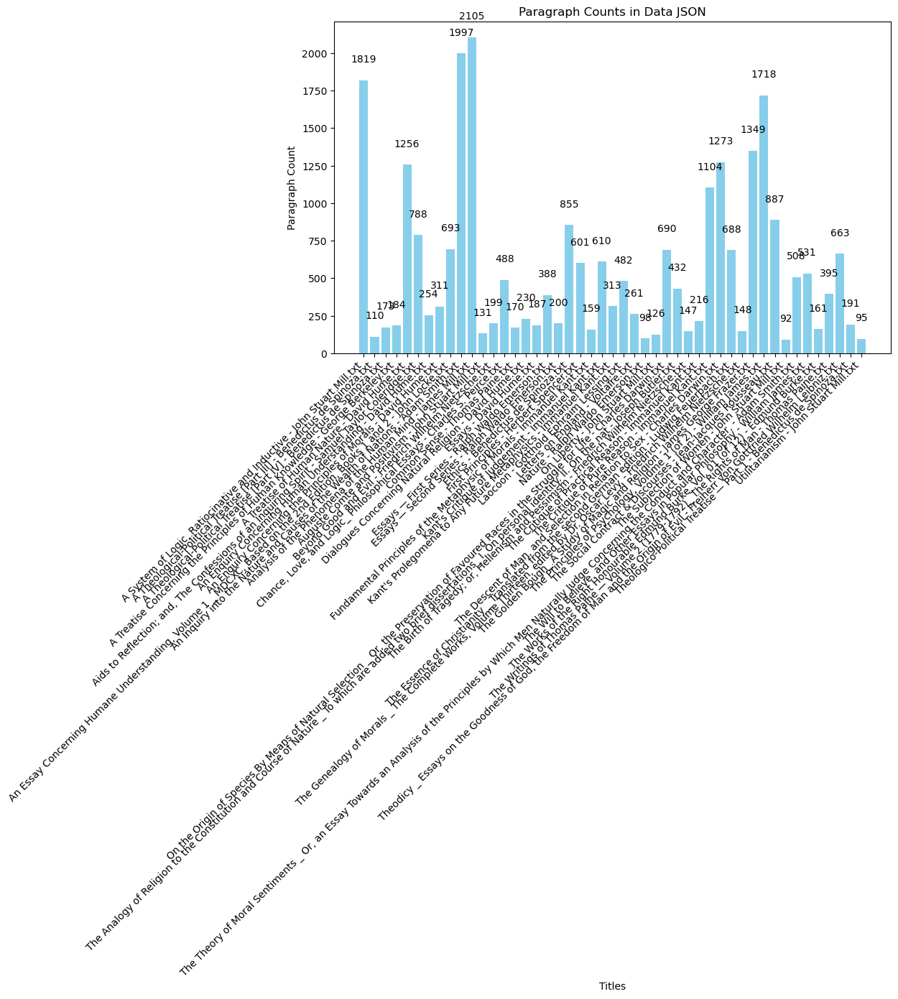

In [33]:
import matplotlib.pyplot as plt
def plot_paragraph_counts(data_dict, plot_title="Paragraph Counts per Title"):
    """
    Plots a bar chart from a dictionary of titles and their paragraph counts.

    Args:
        data_dict (dict): A dictionary where keys are titles (str)
                          and values are paragraph counts (int).
        plot_title (str): The title for the plot.
    """
    if not isinstance(data_dict, dict):
        print("Error: Input must be a dictionary.")
        return
    if not all(isinstance(k, str) and isinstance(v, (int, float)) for k, v in data_dict.items()):
        print("Error: Dictionary keys must be strings and values must be numbers.")
        return
    if not data_dict:
        print("Warning: The dictionary is empty. Nothing to plot.")
        return

    titles = list(data_dict.keys())
    counts = list(data_dict.values())

    plt.figure(figsize=(10, 6)) # Adjust figure size as needed
    bars = plt.bar(titles, counts, color='skyblue')

    # Add labels and title
    plt.xlabel("Titles")
    plt.ylabel("Paragraph Count")
    plt.title(plot_title)
    plt.xticks(rotation=45, ha="right") # Rotate x-axis labels for better readability
    plt.tight_layout() # Adjust layout to prevent labels from overlapping

    # Optional: Add count numbers on top of bars
    for bar in bars:
        yval = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2.0, yval + 0.05 * max(counts), # Adjust offset as needed
                 round(yval, 2), ha='center', va='bottom')


    plt.show()

plot_paragraph_counts(result_dict, "Paragraph Counts in Data JSON")

In [28]:
len(end_data)

26476

In [6]:
repr(data[13951])

"''"

In [72]:
import os
import re

excluded_texts = ['Leviathan - Thomas Hobbes.txt',
                  'Nathan the Wise; a dramatic poem in five acts - Gotthold Ephraim Lessing.txt',
                  'The Communist Manifesto - Karl Marx, Friedrich Engels.txt',
                  'The Fable of the Bees; Or, Private Vices, Public Benefits - Bernard Mandeville.txt',
                  "Hegel's Philosophy of Mind - Georg Wilhelm Friedrich Hegel.txt", #NOT ORIGINAL
                  'An Inquiry Into the Nature and Causes of the Wealth of Nations - Adam Smith, M. Garnier.txt',
                  'Primitive culture, vol. 1 (of 2) - Edward B. Tylor.txt',
                  'Primitive culture, vol. 2 (of 2) - Edward B. Tylor.txt',
                  'Second Treatise of Government - John Locke.txt', #old langUAGE
                  'The Writings of Thomas Paine — Volume 4 (1794-1796)_ The Age of Reason - Thomas Paine.txt',
                  'Theologico-Political Treatise — Part 2 - Benedictus de Spinoza.txt',
                  'Three Dialogues Between Hylas and Philonous in Opposition to Sceptics and Atheists - George Berkeley.txt', #DIALOGUE

                  ]
folder_path_in = r'data_processing\extracted_texts'
folder_path_out = r'data_processing\cleaned_texts'

#re patternsestetst
reference_pattern = re.compile(r'\[.+?\] ?', re.DOTALL)
extra_space_pattern = re.compile(r' {2,}')
starting_number_pattern = re.compile(r'\n( ?\d+ ?\.? ?)')
section_symbol_pattern = re.compile(r' ?§ ?\d* ?\.? ?')
paragraph_break_pattern = re.compile(r'PARAGRAPH_BREAK')
content_pattern = re.compile(r'CONTENT_START(.*?)CONTENT_END', re.DOTALL)
tab_pattern = re.compile(r'\n( *\t  *)')
num_pattern = re.compile(r'\(\d+?\) ?')
big_word_split_pattern = re.compile(r'[A-Z]{1}( )[A-Z]')
numeral_start_pattern = re.compile(r'\n( ?[IVXCM]+\. ?)')

class Cleaner:
    def __init__(self, folder_path_in, folder_path_out):
        self.folder_path_in = folder_path_in
        self.folder_path_out = folder_path_out
        if not os.path.exists(self.folder_path_out):
            os.makedirs(self.folder_path_out)


    # cleaner functions
    def extract_content(self, text):
        match = re.search(content_pattern, text)
        if match:
            return match.group(1).strip()
        return ''

    def reduce_paragraphs(self,content):
        content = re.split(paragraph_break_pattern, content)
        selected_paragraphs = []
        for paragraph in content:
            if paragraph.count('\n') +1 >= 5:
                selected_paragraphs.append(paragraph)
        results = 'PARAGRAPH_BREAK'.join(selected_paragraphs)
        return results


    def clean(self, content):
        content = re.sub(big_word_split_pattern,'',content) # artefacts of html like T REATISE
        content = re.sub(extra_space_pattern, ' ', content) # extra spaces
        content = re.sub(num_pattern,'',content) # (1265)\s
        content = re.sub(reference_pattern, '', content) # references
        content = re.sub(starting_number_pattern, '', content) # starting with number.
        content = re.sub(section_symbol_pattern, '', content) # section symbols
        content = re.sub(tab_pattern, '', content) # remove tabs
        content = re.sub(numeral_start_pattern,'',content)

        return content

    # general logic
    def process(self, path):
        if os.path.isfile(path):
            self._process_file(path)
        else:
            for file in os.listdir(path):
                file_path = os.path.join(path,file)
                self._process_file(file_path)


    def _process_file(self, file_path):
        head, tail = os.path.split(file_path)
        if tail in excluded_texts:
            return
        with open(file_path,'r', encoding='utf-8') as file:
            content = file.read()
        content = self.extract_content(content)
        if content == '':
            print(f'CONTENT NOT FOUND FOR {tail}')
            return
        content = self.reduce_paragraphs(content)
        content = self.clean(content)

        save_path = os.path.join(self.folder_path_out,tail)
        with open(save_path,'w',encoding='utf-8') as f:
            f.write(content)
        print(f'Processed {tail}')

            

In [73]:
cleaner = Cleaner(folder_path_in=folder_path_in,folder_path_out=folder_path_out)
#cleaner.process(r'data_processing\extracted_texts\A System of Logic, Ratiocinative and Inductive - John Stuart Mill.txt')
cleaner.process(folder_path_in)

Processed A System of Logic, Ratiocinative and Inductive - John Stuart Mill.txt
Processed A Theological-Political Treatise [Part III] - Benedictus de Spinoza.txt
Processed A Theological-Political Treatise [Part IV] - Benedictus de Spinoza.txt
Processed A Treatise Concerning the Principles of Human Knowledge - George Berkeley.txt
Processed A Treatise of Human Nature - David Hume.txt
Processed Aids to Reflection; and, The Confessions of an Inquiring Spirit - Samuel Taylor Coleridge.txt
Processed An Enquiry Concerning Human Understanding - David Hume.txt
Processed An Enquiry Concerning the Principles of Morals - David Hume.txt
Processed An Essay Concerning Humane Understanding, Volume 1 _ MDCXC, Based on the 2nd Edition, Books 1 and 2 - John Locke.txt
Processed An Inquiry into the Nature and Causes of the Wealth of Nations - Adam Smith.txt
Processed Analysis of the Phenomena of the Human Mind - James Mill.txt
Processed Auguste Comte and Positivism - John Stuart Mill.txt
Processed Beyond G

In [ ]:
import ebooklib
from ebooklib import epub
from pprint import pprint


book = epub.read_epub(r'data_processing\input\epubs\pg989-images-3.epub')



Type:        EpubBook
String form: <ebooklib.epub.EpubBook object at 0x0000014A9380E060>
File:        c:\users\user\conda_envs\nlp\lib\site-packages\ebooklib\epub.py
Docstring:   <no docstring>

In [7]:
all_meta

{'generator': ('', {'name': 'generator', 'content': 'Ebook-lib 0.19.0'}),
 'identifier': ('id123456', {'id': 'id'}),
 'title': ('My Awesome Book', None),
 'language': ('en', None),
 'creator': ('John Doe', {'id': 'creator'}),
 'publisher': ('My Ebook Publishing', None),
 'rights': ('All rights reserved.', None),
 'subject': ('Science Fiction', None),
 'meta': ('Smith, Jane',
  {'refines': '#creator', 'property': 'file-as', 'scheme': 'marc:relators'})}

In [14]:
import ebooklib
from ebooklib import epub
book = epub.read_epub(r'E:\code\dta\cls\exam\data_processing\gutenberg_epubs\pg4280-images-3.epub')
datas = ['title','identifier','creator','contributor','date','coverage','description']
for data in datas:
    print(book.get_metadata('DC',data))


[('The Critique of Pure Reason', {})]
[('http://www.gutenberg.org/4280', {'id': 'id'})]
[('Immanuel Kant', {'id': 'author_0'})]
[('J. M. D. Meiklejohn', {'id': 'author_1'})]
[('2003-07-01', {})]
[]
[]


In [19]:
toc = book.toc
toc

 (<ebooklib.epub.Section at 0x20d15f6a900>,
   <ebooklib.epub.Link at 0x20d15f69fa0>]),
 (<ebooklib.epub.Section at 0x20d15f6b350>,
   <ebooklib.epub.Link at 0x20d16544440>]),
 (<ebooklib.epub.Section at 0x20d15f6a180>,
   <ebooklib.epub.Link at 0x20d16544d40>]),

In [20]:
from ebooklib import epub

def print_toc(toc, level=0):
    for item in toc:
        if isinstance(item, epub.Link):
            print('  ' * level + f"- {item.title} ({item.href})")
        elif isinstance(item, tuple):
            print('  ' * level + f"- {item[0].title} ({item[0].href})")
            print_toc(item[1], level + 1)

print_toc(book.toc)

- The Critique of Pure Reason (7821593330858513041_4280-h-0.htm.xhtml#pgepubid00000)
- Translated by J. M. D. Meiklejohn (7821593330858513041_4280-h-0.htm.xhtml#pgepubid00001)
- Contents (7821593330858513041_4280-h-0.htm.xhtml#pgepubid00002)
- PREFACE TO THE FIRST EDITION 1781 (7821593330858513041_4280-h-1.htm.xhtml#pgepubid00003)
- PREFACE TO THE SECOND EDITION 1787 (7821593330858513041_4280-h-2.htm.xhtml#pgepubid00004)
- Introduction (7821593330858513041_4280-h-3.htm.xhtml#pgepubid00005)
  - I. Of the difference between Pure and Empirical Knowledge (7821593330858513041_4280-h-3.htm.xhtml#pgepubid00006)
  - II. The Human Intellect, even in an Unphilosophical State, is in Possession of Certain Cognitions “à priori”. (7821593330858513041_4280-h-3.htm.xhtml#pgepubid00007)
  - III. Philosophy stands in need of a Science which shall Determine the Possibility, Principles, and Extent of Human Knowledge “à priori” (7821593330858513041_4280-h-3.htm.xhtml#pgepubid00008)
  - IV. Of the Differenc

In [26]:
spine = book.spine
spine

[('coverpage-wrapper', 'yes'),
 ('pg-header', 'yes'),
 ('item4', 'yes'),
 ('item5', 'yes'),
 ('item6', 'yes'),
 ('item7', 'yes'),
 ('item8', 'yes'),
 ('item9', 'yes'),
 ('item10', 'yes'),
 ('item11', 'yes'),
 ('item12', 'yes'),
 ('item13', 'yes')]

In [25]:
from bs4 import BeautifulSoup, NavigableString
for item in book.spine:
    # Get the actual item object from manifest using its id
    doc_item = book.get_item_with_id(item[0])
    if not doc_item or doc_item.get_type() != ebooklib.ITEM_DOCUMENT:
        continue

    soup = BeautifulSoup(doc_item.get_content(), 'html.parser')
    body_content = soup.find('body')
    for element in body_content.children:
        if isinstance(element, NavigableString): # Skip plain strings if they are direct children
            if element.strip(): # only if it's not just whitespace
    # Sometimes stray text nodes exist. Decide if you want them.
    # For now, we focus on structured elements.
                pass 
            continue
        print(element)

<div class="x-ebookmaker-cover">
<svg height="100%" preserveaspectratio="xMidYMid meet" version="1.1" viewbox="0 0 500 700" width="100%" xmlns="http://www.w3.org/2000/svg" xmlns:xlink="http://www.w3.org/1999/xlink">
<image height="700" width="500" xlink:href="5903724420998147712_cover.jpg"/>
</svg>
</div>
<section class="pg-boilerplate pgheader" id="pg-header" lang="en"><h2 id="pg-header-heading" title="">The Project Gutenberg eBook of <span id="pg-title-no-subtitle" lang="en">The Critique of Pure Reason</span></h2>
<div>This ebook is for the use of anyone anywhere in the United States and
most other parts of the world at no cost and with almost no restrictions
whatsoever. You may copy it, give it away or re-use it under the terms
of the Project Gutenberg License included with this ebook or online
at <a class="reference external" href="https://www.gutenberg.org">www.gutenberg.org</a>. If you are not located in the United States,
you will have to check the laws of the country where you 

In [27]:
book_pas = epub.read_epub(r'E:\code\dta\cls\exam\data_processing\gutenberg_epubs\pg18269-images-3.epub')
spine_p = book_pas.spine
spine_p

[('coverpage-wrapper', 'yes'),
 ('pg-header', 'yes'),
 ('item5', 'yes'),
 ('item6', 'yes'),
 ('item7', 'yes'),
 ('item8', 'yes'),
 ('item9', 'yes'),
 ('pg-footer', 'yes')]

In [1]:
from bertopic import BERTopic
import my_utils as mu
from umap import UMAP
from sklearn.cluster import HDBSCAN
import pandas as pd
import json
from nltk.tokenize import sent_tokenize, word_tokenize

c:\Users\User\.local\share\mamba\envs\nlp\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Add data

In [3]:
df = pd.read_csv('data\phil_nlp.csv')

df_works = df.groupby('title')['sentence_str'].agg(' '.join).reset_index()
df_works.head()
works_list = df_works['sentence_str'].tolist()

<>:1: SyntaxWarning: invalid escape sequence '\p'
<>:1: SyntaxWarning: invalid escape sequence '\p'
C:\Users\User\AppData\Local\Temp\ipykernel_8760\2664087879.py:1: SyntaxWarning: invalid escape sequence '\p'
  df = pd.read_csv('data\phil_nlp.csv')
C:\Users\User\AppData\Local\Temp\ipykernel_8760\2664087879.py:1: DtypeWarning: Columns (8) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('data\phil_nlp.csv')


In [4]:
topic_dist, document_dist = mu.tm_class_LDA(df_works['sentence_str'])

man         42.007315
way         38.033618
god         35.866456
things      35.785633
does        35.123410
time        34.706921
say         31.978350
reason      31.693729
good        29.363776
world       28.537322
nature      26.291185
thing       24.524845
make        24.432530
possible    23.686872
form        23.201530
life        23.044544
people      22.709652
law         22.362675
Name: Topic 8, dtype: float64


In [6]:
topic_dist.head()

,aa,aagravatlllilllllm,aaion,aaions,aaiotzes,aaivity,aala,aances,aappearances,aardvark,...,ﬂuctuations,ﬂuid,ﬂuidity,ﬂuids,ﬂurry,ﬂute,ﬂuttering,ﬂux,ﬂy,ﬂying
Topic 0,0.261549,0.211783,0.213004,0.203636,0.259745,0.208607,0.254473,0.185439,0.246618,0.203533,...,0.216929,0.204000,0.204383,0.209570,0.203783,0.233236,0.196496,0.251948,0.224154,0.274577
Topic 1,0.217893,0.227151,0.236187,0.256823,0.207518,0.208626,0.222145,0.206913,0.232410,0.241534,...,0.263552,0.253754,0.213358,0.217287,0.226412,0.234203,0.270250,0.222247,0.221807,0.265789
Topic 2,0.227075,0.209780,0.206326,0.227395,0.263340,0.225883,0.237332,0.205213,0.193311,0.188487,...,0.244000,0.189155,0.256308,0.235988,0.197798,0.238227,0.213057,0.222050,0.202493,0.226634
Topic 3,3.195540,0.912145,0.980067,1.711700,0.972037,1.007020,0.926719,0.989151,0.992919,1.763530,...,6.800968,16.187787,1.748369,1.235308,0.963817,1.749814,0.236089,10.639861,4.078303,3.513195
Topic 4,0.226416,0.223683,0.208434,0.211457,0.201987,0.233853,0.238996,0.209502,0.199832,0.208817,...,0.239740,0.247925,0.207697,0.227574,0.269606,0.187985,0.256580,0.220903,0.237360,0.238693


preprocess

In [11]:
sentences = [sent_tokenize(work) for work in works_list]
sentences = [sentence for doc in sentences for sentence in doc]

In [ ]:
import sklearn.feature_extraction.text as text
def tm_bertopic(sentences):
    vectorizer_model = text.CountVectorizer(stop_words="english", lowercase=True, ngram_range=(1,2))
    topic_model = BERTopic(
        vectorizer_model=vectorizer_model,
        verbose=True,
        min_topic_size=5,
        
        )
    topics, probabilities = topic_model.fit_transform(sentences)
    topic_model.get_topic_info()
    return topics, probabilities, topic_model





2025-05-22 23:47:30,974 - BERTopic - Embedding - Transforming documents to embeddings.
Batches: 100%|██████████| 3/3 [00:17<00:00,  5.82s/it]
2025-05-22 23:47:53,525 - BERTopic - Embedding - Completed ✓
2025-05-22 23:47:53,526 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-05-22 23:47:53,609 - BERTopic - Dimensionality - Completed ✓
2025-05-22 23:47:53,610 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-05-22 23:47:53,617 - BERTopic - Cluster - Completed ✓
2025-05-22 23:47:53,620 - BERTopic - Representation - Extracting topics from clusters using representation models.
2025-05-22 23:48:19,632 - BERTopic - Representation - Completed ✓


,Topic,Count,Name,Representation,Representative_Docs
0,-1,29,-1_man_time_does_things,"[man, time, does, things, way, nature, world, ...",[ This book first arose out of a passage in Bo...
1,0,20,0_consciousness_world_does_object,"[consciousness, world, does, object, nature, f...","[Here, misprints apart, they are reprinted in ..."
2,1,20,1_things_man_good_say,"[things, man, good, say, said, ideas, reason, ...",[It has ever been seen that men in general hav...


In [26]:
BERTopic?

Init signature:
BERTopic(
    language: str = 'english',
    top_n_words: int = 10,
    n_gram_range: Tuple[int, int] = (1, 1),
    min_topic_size: int = 10,
    nr_topics: Union[int, str] = None,
    low_memory: bool = False,
    calculate_probabilities: bool = False,
    seed_topic_list: List[List[str]] = None,
    zeroshot_topic_list: List[str] = None,
    zeroshot_min_similarity: float = 0.7,
    embedding_model=None,
    umap_model: umap.umap_.UMAP = None,
    hdbscan_model: hdbscan.hdbscan_.HDBSCAN = None,
    vectorizer_model: sklearn.feature_extraction.text.CountVectorizer = None,
    ctfidf_model: sklearn.feature_extraction.text.TfidfTransformer = None,
    representation_model: bertopic.representation._base.BaseRepresentation = None,
    verbose: bool = False,
)
Docstring:     
BERTopic is a topic modeling technique that leverages BERT embeddings and
c-TF-IDF to create dense clusters allowing for easily interpretable topics
whilst keeping important words in the topic descript

In [19]:



umap_model = UMAP(n_components=2)
hdbscan_model = HDBSCAN(min_cluster_size=2, metric='cosine', cluster_selection_epsilon=0.5)
topic_model = BERTopic(umap_model=umap_model, hdbscan_model=hdbscan_model, calculate_probabilities=True)

topics, probabilities = topic_model.fit_transform(works_list)

In [23]:
topic_model.get_topic(1)

[('the', np.float64(0.18956394938047166)),
 ('of', np.float64(0.16063073166413575)),
 ('in', np.float64(0.08099190264258585)),
 ('to', np.float64(0.07784661756687913)),
 ('and', np.float64(0.07666284021676924)),
 ('is', np.float64(0.04309075977795306)),
 ('it', np.float64(0.042283931045013295)),
 ('which', np.float64(0.038687344747194305)),
 ('that', np.float64(0.03863322788844552)),
 ('by', np.float64(0.037889132976983986))]

In [22]:
print(topics)

[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]


In [20]:
topic_info = topic_model.get_topic_info()

topic_model.visualize_barchart()
topic_model.visualize_heatmap()
topic_model.visualize_hierarchy()

topic_model.get_topic(1)

ModuleNotFoundError: No module named 'plotly.validator_cache'

In [ ]:
# topic modeling 
df = pd.read_csv('data\phil_nlp.csv')

# topic modeling all works phil_nlp

df_works = df.groupby('title')['sentence_str'].agg(' '.join).reset_index()
df_works.head()
works_list = df_works['sentence_str'].tolist()

topic_model, topics, probabilities = mu.tm_bertopic(works_list)

topic_info = topic_model.get_topic_info()
topic_model.visualize_barchart()
topic_model.visualize_heatmap()
topic_model.visualize_hierarchy()
topic_model.get_topic(1)